In [1]:
import numpy as np
import scipy as sp
from scipy import io
import cv2 as cv 
import matplotlib.pyplot as plt
import pylab
import os # for reading all files in a folder
pylab.rcParams['figure.figsize'] = (12.0, 10.0)

# Yaqin Huang

# Condensation 9c

You'll have to call the code below four times (once each with 'll','lr', 'ul', 'ur': lower left, lower right, upper left, ipper right). For each time you'll get an estimated track (2D locations over time) of one of the corners of the pattern moved. Note that we're saving off the single MAP estimate at each frame, but the particles in the Particle Filter are attempting to keep track of the whole posterior distribution. 

Most TO DO parts below should be copy-paste from Practical9a and Practical9b.

computeLikelihood has been modified from its previous versions to cope with these particular gray-scale images.


Qustions you could ask yourself (not a TO DO): 
- Can you find a pattern between the movement of the particles and the movement of the camera relative to the scene?
- When is the MAP estimate especially good/bad?
- What is the relationship to the amount of noise? (--> experiment with different levels!)
- Why do different numbers of particles lead to very differenet results (for example 50 vs. 2000)? 

In [2]:
#Likelihood function is simple patch similarity

def computeLikelihood(image, template):
    #opencv's available methods - experiment with these
    #careful what range the output is!
    methods = [cv.TM_CCOEFF, cv.TM_CCOEFF_NORMED, cv.TM_CCORR,
            cv.TM_CCORR_NORMED, cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]
    
    likelihood = cv.matchTemplate(image[:,:,2], template, methods[0])
    # (You can also try converting the image to greyscale instead of using the third channel as above with 
    # cv.cvtColor(image, cv.COLOR_BGR2GRAY))
    
    #we can pad to make this the size of the input image (for easier indexing)   
    pad_first = int(template.shape[0])
    pad_second = int(template.shape[1])
    pad_amounts = ((0, pad_first-1), (0, pad_second-1))
    likelihood = np.pad(likelihood, pad_amounts, 'constant')
    likelihood[likelihood<0] = 0 # to avoid negative weights 
    
    # apply a 10x10 averaging filter for stability. You can experiment with different sizes. 
    kernel = np.ones((10,10),np.float32)/100
    smoothed = cv.filter2D(likelihood,-1,kernel) 
    return smoothed 

In [3]:

def HW2_Practical9c(corner):
    template = sp.io.loadmat(corner+'.mat')['pixelsTemplate']
    #let's show the template
    print('We are matching this template with shape: ', template.shape)
    plt.imshow(template)
    plt.show()

    # Load all images in folder
    images = []
    iFrame = 0
    folder = 'Pattern01/'
    lst = os.listdir(folder)
    lst.sort()

    for frameNum in lst:
        images.append(cv.imread(folder+frameNum))
        iFrame += 1
    # plot first image 
    plt.imshow(images[0])
    plt.show()

    imgHeight, imgWidth, colors = images[0].shape
    numParticles = 2000;
    weight_of_samples = np.ones((numParticles,1))

    # TO DO: normalize the weights (may be trivial this time) [done]
    weight_of_samples = weight_of_samples/np.sum(weight_of_samples) #replace this 

    # Initialize which samples from "last time" we want to propagate: all of
    # them!:
    samples_to_propagate = range(0, numParticles)


    # ============================
    # NOT A TO DO: You don't need to change the code below, but eventually you may
    # want to vary the number of Dims (compare for example to lab 9b) 
    numDims_w = 2;
    # Here we randomly initialize some particles throughout the space of w:
    particles_old = np.random.rand(numParticles, numDims_w)
    particles_old[:,0] = particles_old[:,0] * imgHeight
    particles_old[:,1] = particles_old[:,1] * imgWidth
    # ============================

    #Initialize a temporary array r to store the per-frame MAP estimate of w. This is what we'll return in the end.
    r = np.zeros((iFrame, numDims_w));

    for iTime in range(iFrame):
        print('Processing Frame', iTime)
        # TO DO: compute the cumulative sume of the weights. [done]
        cum_hist_of_weights = np.cumsum(weight_of_samples) # replace this
        #print(weight_of_samples)


        # ==============================================================
        # Resample the old distribution at time t-1, and select samples, favoring
        # those that had a higher posterior probability.
        # ==============================================================
        samples_to_propagate = np.zeros(numParticles, dtype=np.int32)

        # Pick random thresholds in the cumulative probability's range [0,1]:
        some_threshes = np.random.rand(numParticles)


        # For each random threshold, find which sample in the ordered set is
        # the first one to push the cumulative probability above that
        # threshold, e.g. if the cumulative histogram goes from 0.23 to 0.26
        # between the 17th and 18th samples in the old distribution, and the
        # threshold is 0.234, then we'll want to propagate the 18th sample's w
        # (i.e. particle #18).

        for sampNum in range(numParticles): 
            thresh = some_threshes[sampNum]
            for index in range (numParticles):
                if cum_hist_of_weights[index] > thresh:
                    break
            samples_to_propagate[sampNum] = index

        # Note: it's ok if some of the old particles get picked repeatedly, while
        # others don't get picked at all.


        # =================================================
        # Visualize if you want
        # =================================================
        #plt.title('Cumulative histogram of probabilities for sorted list of particles')
        #plt.plot(np.zeros(numParticles), some_threshes,'b.')
        #plt.plot(range(0, numParticles), cum_hist_of_weights, 'rx-')
        #which_sample_ids = np.unique(samples_to_propagate)
        #how_many_of_each = np.bincount(np.ravel(samples_to_propagate))
        #for k in range(len(which_sample_ids)):
        #    plt.plot(which_sample_ids[k], 0, 'bo-', markersize = 3 * how_many_of_each[k], markerfacecolor='white')
        #plt.xlabel('Indeces of all available samples, with larger blue circles for frequently re-sampled particles\n(Iteration %01d)' % iTime)
        #plt.ylabel('Cumulative probability');
        #plt.show()
        # =================================================
        # =================================================

        # Predict where the particles we sampled from the old distribution of 
        # state-space will go in the next time-step. This means we have to apply 
        # the motion model to each old sample.
        particles_new = np.zeros_like(particles_old)
        for particleNum in range(numParticles):
            # TO DO: Incorporate some noise, e.g. Gaussian noise with std 20,
            # into the current location (particles_old), to give a Brownian
            # motion model.
            noise = 20*np.random.randn(1,2)
            ind = samples_to_propagate[particleNum]
            particles_new[particleNum, :] =  particles_old[ind, :]+ noise; # replace this 
            
        # TO DO: Not initially, but change the motion model above to have
        # different degrees of freedom, and optionally completely different
        # motion models. See Extra Credit for more instructions.

        #calculate likelihood function
        likelihood = computeLikelihood(images[iTime], template)

        #plot results
        f, axarr = plt.subplots(1, 2)
        axarr[0].imshow(images[iTime])
        axarr[0].set_title('Particles')
        # now draw the particles onto the image
        axarr[0].plot(particles_new[:,1]+template.shape[1]/2, particles_new[:,0]+template.shape[0]/2, 'rx')

        #plot the likelihood
        axarr[1].imshow(likelihood)
        axarr[1].set_title('Likelihood')





        # From here we incorporate the data for the new state (time t):
        # The new particles accompanying predicted locations in state-space
        # for time t, are missing their weights: how well does each particle
        # explain the observations x_t?
        for particleNum in range(numParticles):

            # Convert the particle from state-space w to measurement-space x:
            # Note: that step is trivial here since both are in 2D space of image
            # coordinates

            # Within the loop, we evaluate the likelihood of each particle:
            particle = particles_new[particleNum, :]
            # Check that the predicted location is a place we can really evaluate
            # the likelihood.
            inFrame = particle[0] >= 0.0 and  particle[0] <= imgHeight and particle[1] >= 0.0 and particle[1] <= imgWidth
            if inFrame:
                minX = particle[1]
                minY = particle[0]

                weight_of_samples[particleNum] = likelihood[int(minY), int(minX)]

            else:
                weight_of_samples[particleNum] = 0.0

        # TO DO: normalize the weights [done]
        weight_of_samples = weight_of_samples/np.sum(weight_of_samples) # replace this
        
        # find the location of the particle with highest weight
        indices = np.argsort(weight_of_samples,0)
        bestScoringParticles = particles_new[np.squeeze(indices[-15:]), :]
        plt.plot(bestScoringParticles[-1:,1], bestScoringParticles[-1:,0], 'rx')
        # Return the MAP of middle position. Add template.shape/2 because matchTemplate finds the position of the upper left corner 
        # of the template. We want to plot the centre of the template. 
        r[iTime,:] = bestScoringParticles[-1,1]+template.shape[1]/2,bestScoringParticles[-1,0]+template.shape[0]/2
        print(r[iTime,:])   
        plt.show()

        #print the original image and the position of the tracked corner.
        plt.imshow(images[iTime])
        plt.plot(r[iTime,0],r[iTime,1],'rx')
        plt.show()
        # Now we're done updating the state for time t. 
        # For Condensation, just clean up and prepare for the next round of 
        # predictions and measurements:
        particles_old = particles_new

    return r

We are matching this template with shape:  (25, 28)


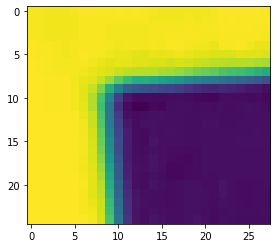

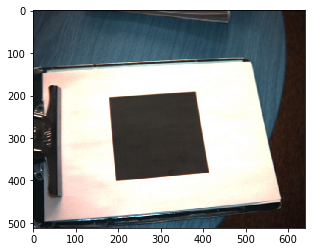

Processing Frame 0
[181.11968483 211.24773362]


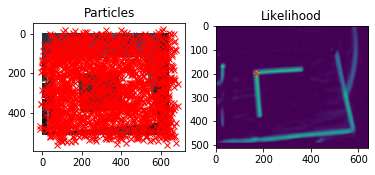

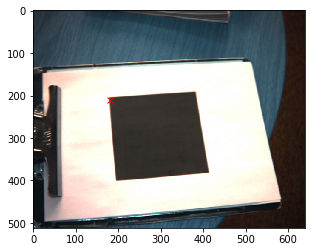

Processing Frame 1
[184.94582279 208.06625516]


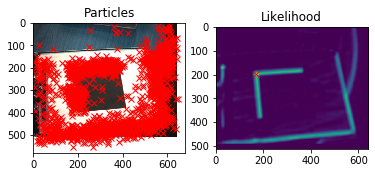

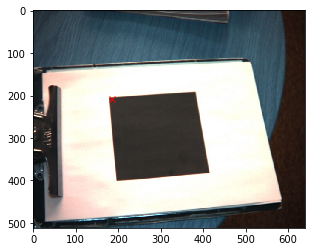

Processing Frame 2
[186.47074295 210.21296172]


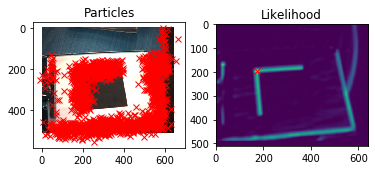

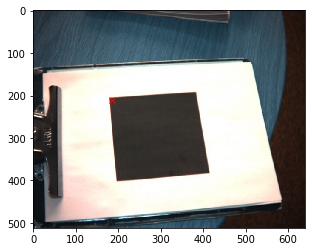

Processing Frame 3
[187.93708054 214.24107735]


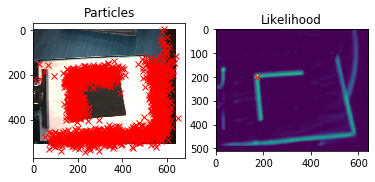

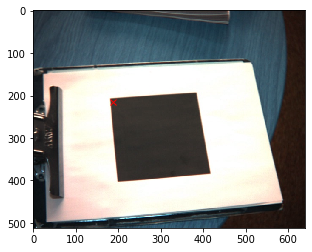

Processing Frame 4
[190.79189426 214.77445458]


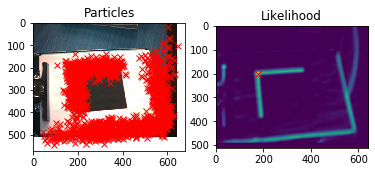

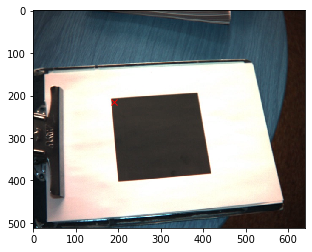

Processing Frame 5
[189.17980939 213.28079419]


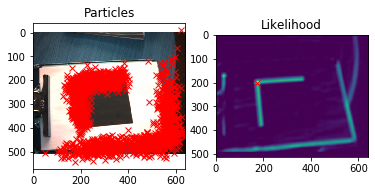

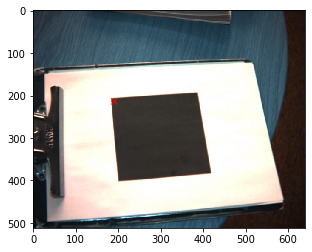

Processing Frame 6
[191.26904019 210.18627005]


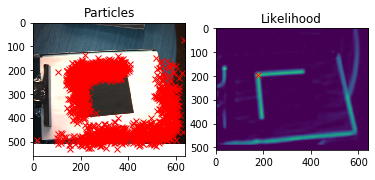

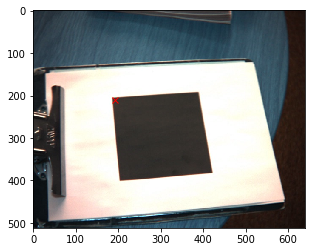

Processing Frame 7
[195.50351006 209.53213107]


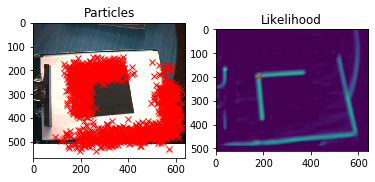

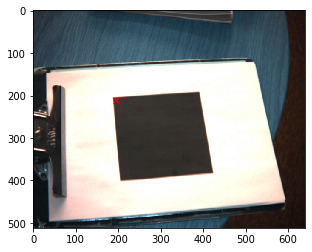

Processing Frame 8
[196.69938124 211.99381737]


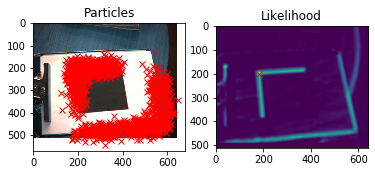

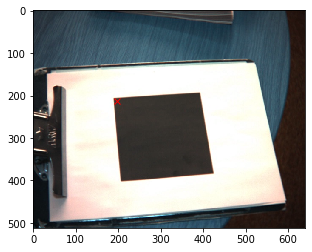

Processing Frame 9
[196.81458915 210.39981667]


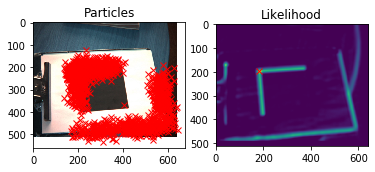

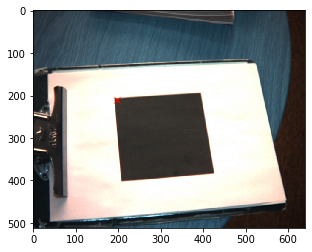

Processing Frame 10
[195.71726152 212.18358086]


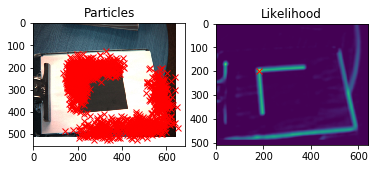

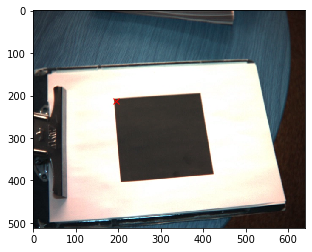

Processing Frame 11
[194.97610294 214.45184588]


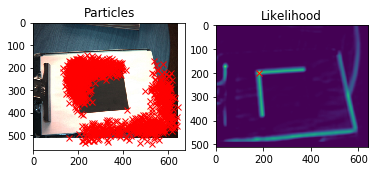

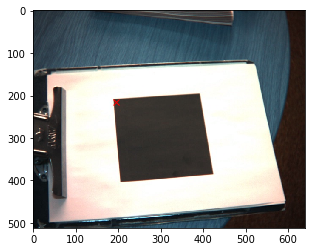

Processing Frame 12
[195.03237122 213.52768112]


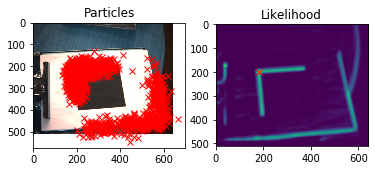

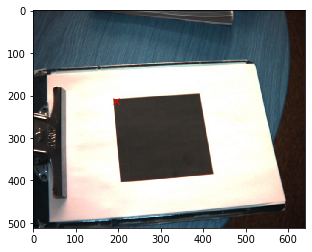

Processing Frame 13
[197.9514251  211.85186894]


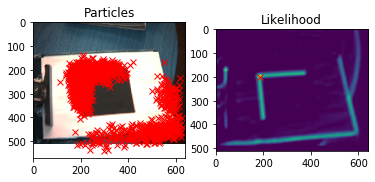

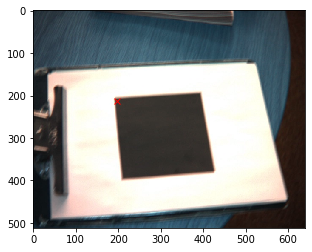

Processing Frame 14
[205.22054988 202.25115622]


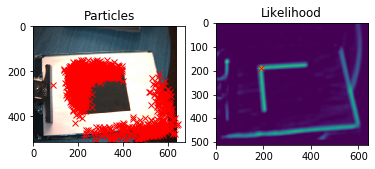

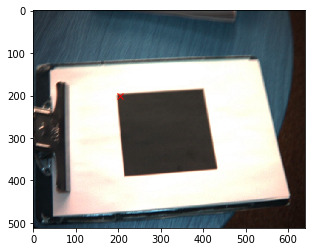

Processing Frame 15
[205.32935836 196.0124932 ]


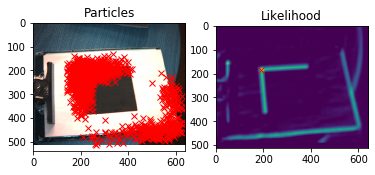

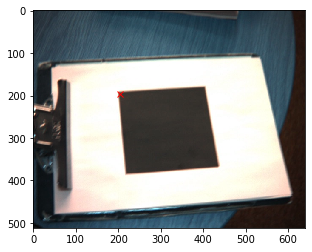

Processing Frame 16
[211.90985193 191.57123279]


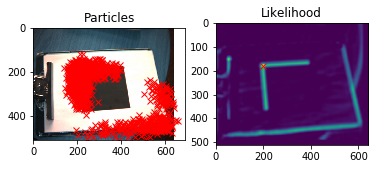

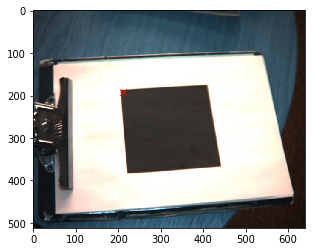

Processing Frame 17
[211.32723016 193.40451567]


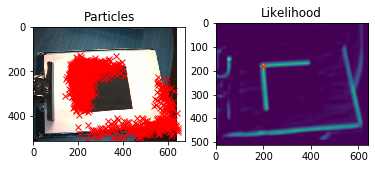

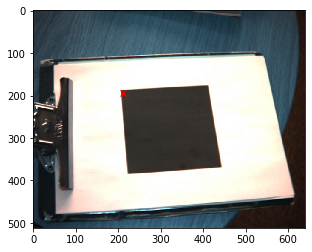

Processing Frame 18
[216.26774821 189.95537973]


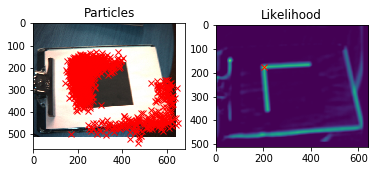

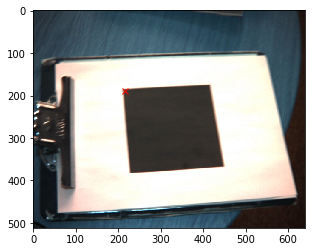

Processing Frame 19
[222.66427842 189.1418134 ]


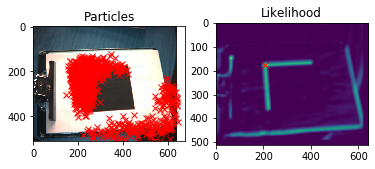

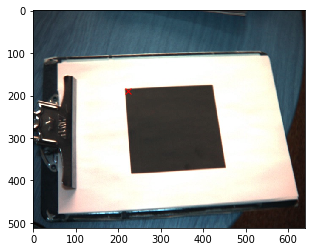

Processing Frame 20
[224.6613578  193.14454174]


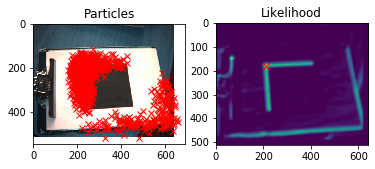

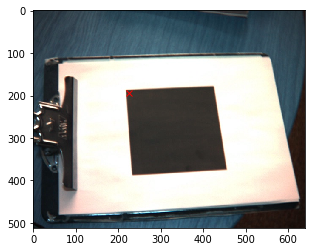

Processing Frame 21
[228.39913044 195.57679006]


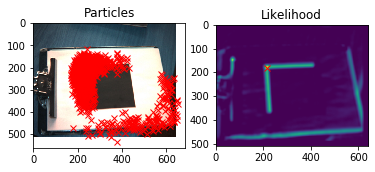

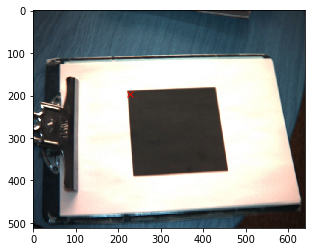

Processing Frame 22
[231.13599157 197.62693794]


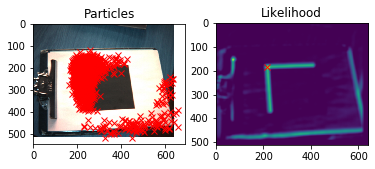

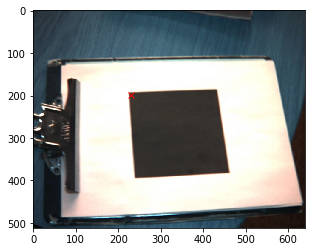

Processing Frame 23
[236.30759754 198.30683901]


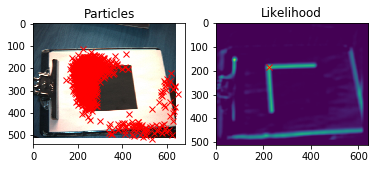

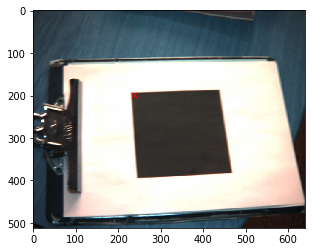

Processing Frame 24
[241.0545018  198.22158343]


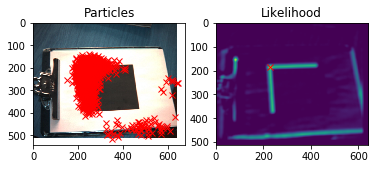

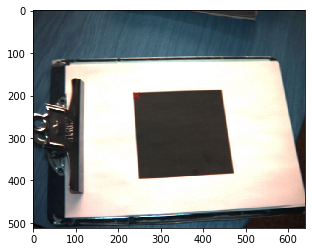

Processing Frame 25
[245.69785307 198.58824195]


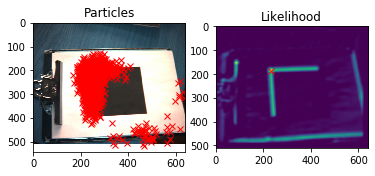

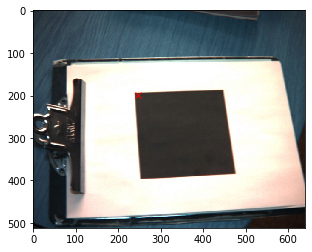

Processing Frame 26
[249.48518964 199.20203562]


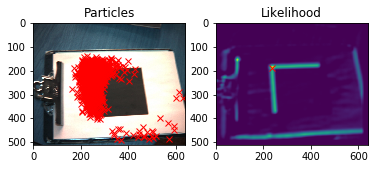

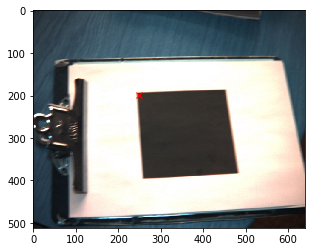

Processing Frame 27
[257.33086981 195.84284058]


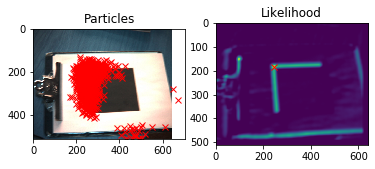

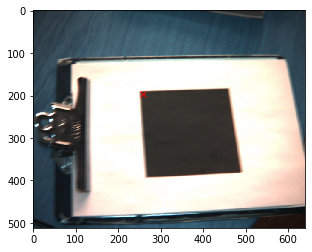

Processing Frame 28
[266.63812461 192.53311715]


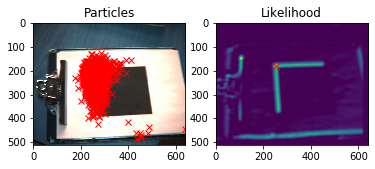

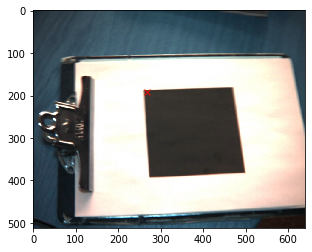

Processing Frame 29
[271.75880984 194.91509318]


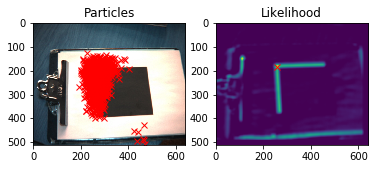

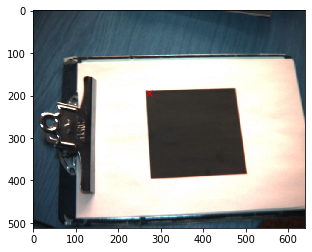

Processing Frame 30
[273.48932522 198.8544386 ]


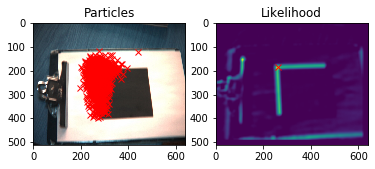

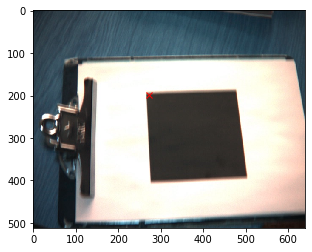

Processing Frame 31
[272.70062473 207.51457026]


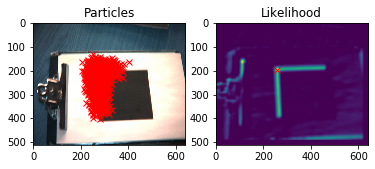

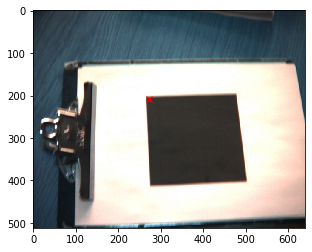

Processing Frame 32
[271.68676773 215.97810656]


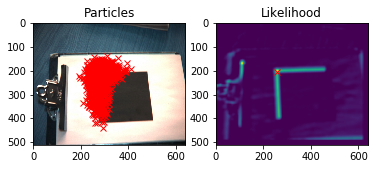

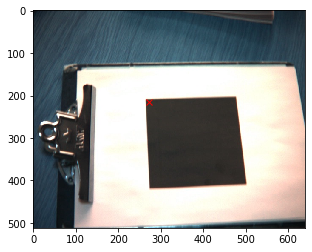

Processing Frame 33
[271.39109441 220.22117704]


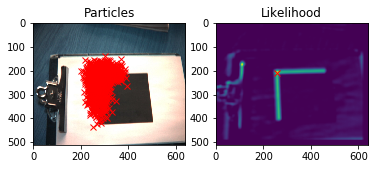

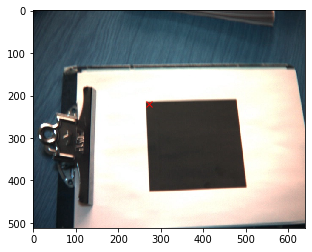

Processing Frame 34
[268.88658527 225.18420195]


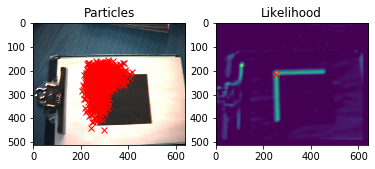

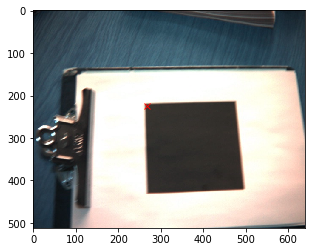

Processing Frame 35
[261.12943127 228.67222601]


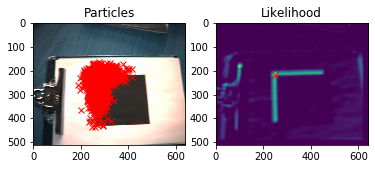

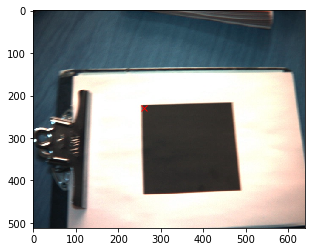

Processing Frame 36
[252.65051922 225.95589901]


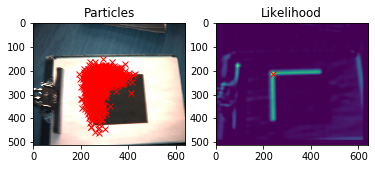

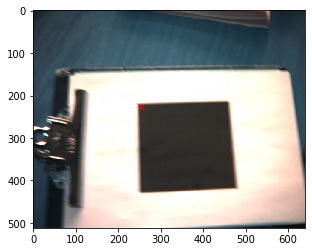

Processing Frame 37
[238.57430817 219.94633914]


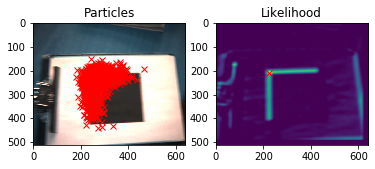

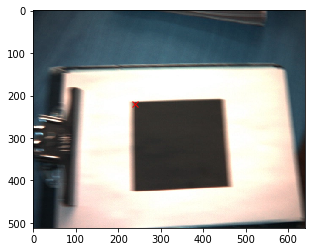

Processing Frame 38
[222.9144963  217.15771318]


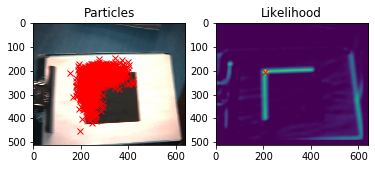

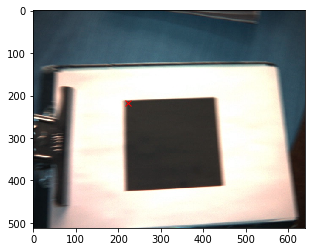

Processing Frame 39
[206.63889973 220.11473792]


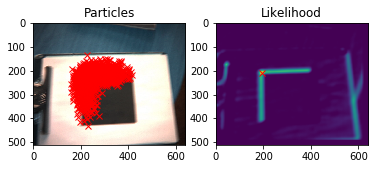

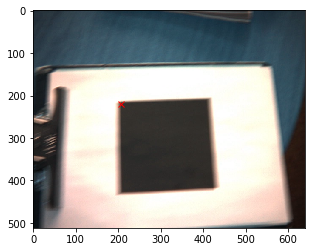

Processing Frame 40
[189.61387157 227.95379945]


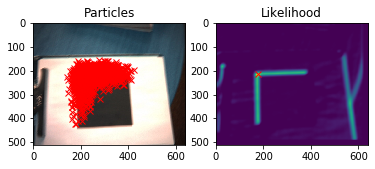

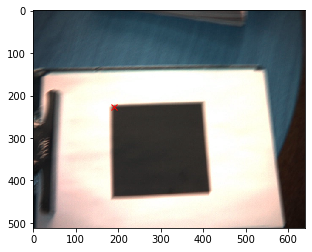

Processing Frame 41
[179.48537844 238.78503126]


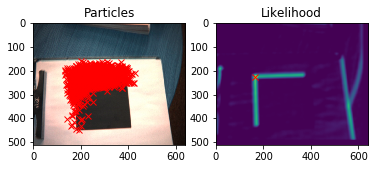

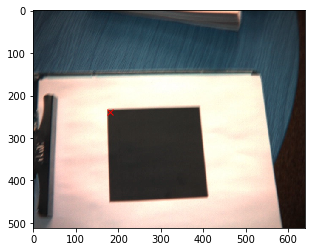

Processing Frame 42
[175.29806581 248.02134857]


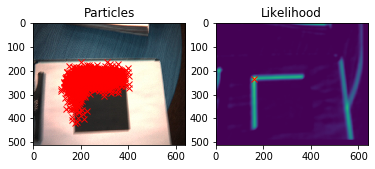

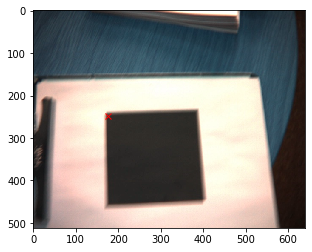

Processing Frame 43
[164.29334838 262.61398485]


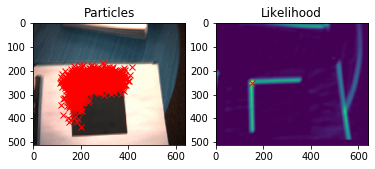

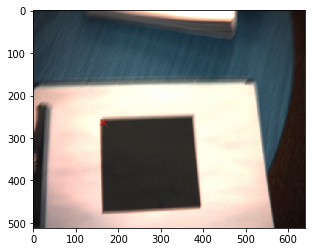

Processing Frame 44
[158.52117196 270.30472868]


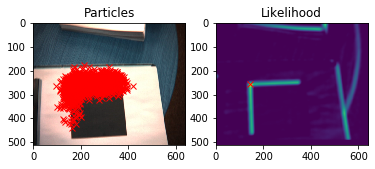

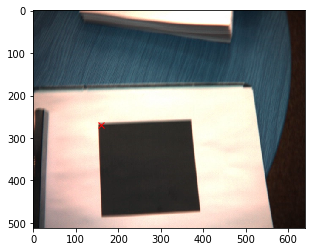

Processing Frame 45
[158.1098925  280.33163563]


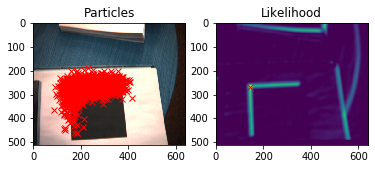

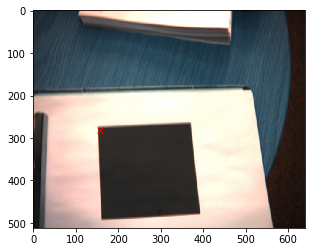

Processing Frame 46
[159.75005255 284.23827842]


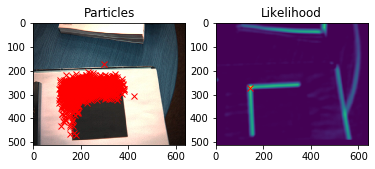

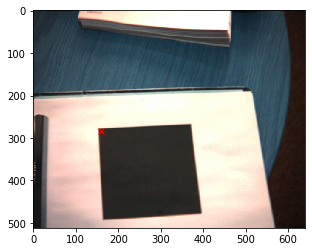

Processing Frame 47
[163.17465327 279.07377875]


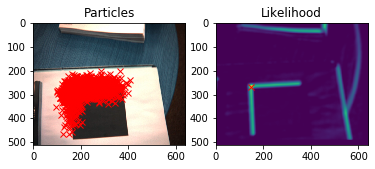

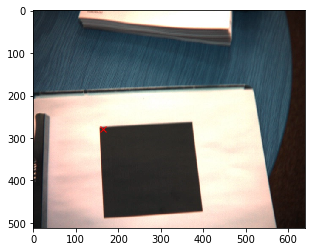

Processing Frame 48
[162.60375707 274.90554694]


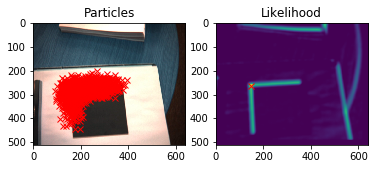

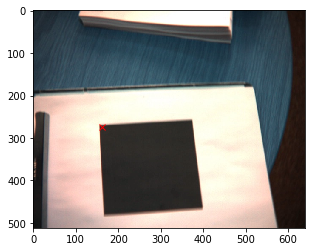

Processing Frame 49
[164.24235583 267.10756281]


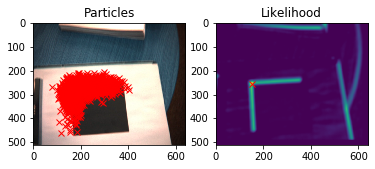

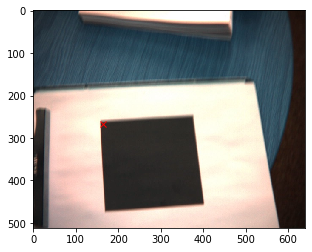

Processing Frame 50
[167.84791374 257.70003914]


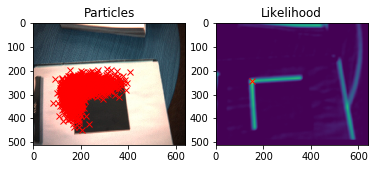

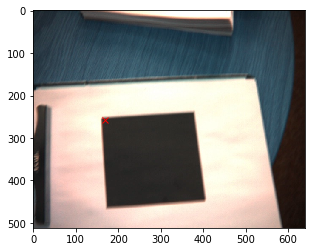

Processing Frame 51
[170.02713562 248.99629808]


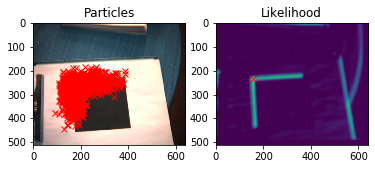

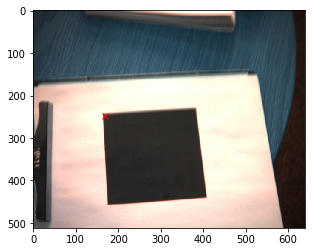

Processing Frame 52
[171.85312163 249.14804433]


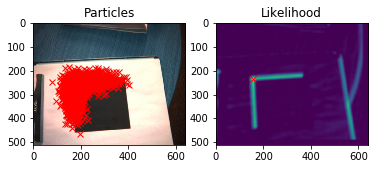

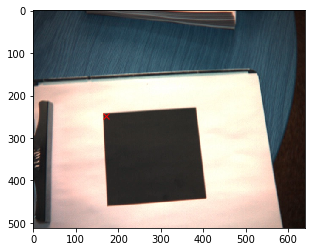

Processing Frame 53
[168.20581836 251.18107895]


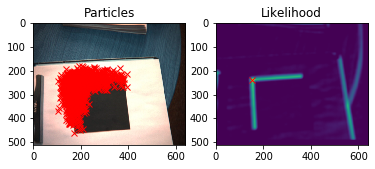

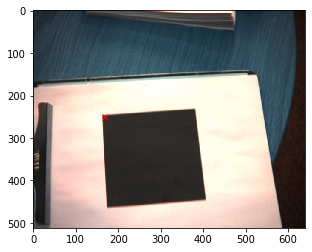

Processing Frame 54
[167.78068283 257.41816145]


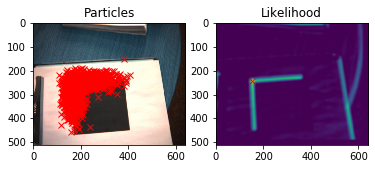

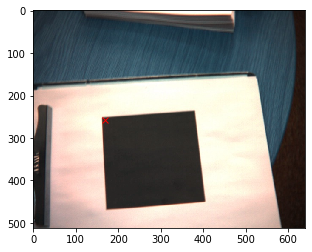

Processing Frame 55
[162.39802946 260.55388406]


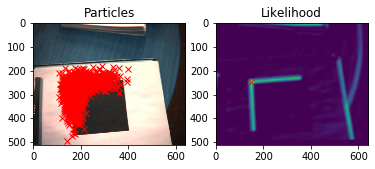

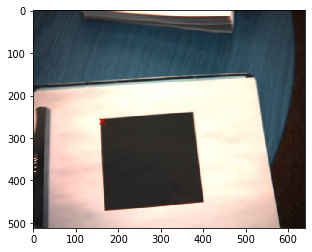

Processing Frame 56
[161.31602314 260.392421  ]


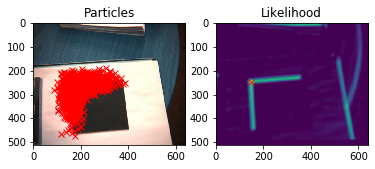

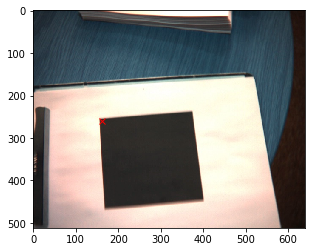

Processing Frame 57
[162.90476035 250.84164124]


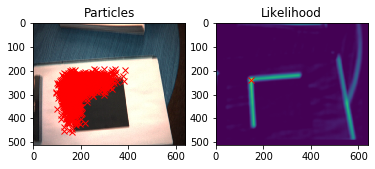

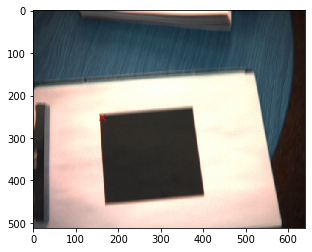

Processing Frame 58
[161.4034453  241.12837846]


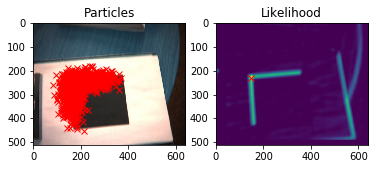

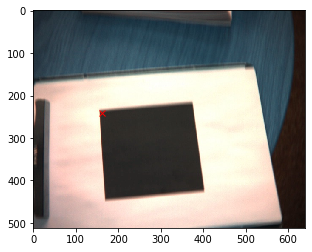

Processing Frame 59
[161.31752222 230.82636465]


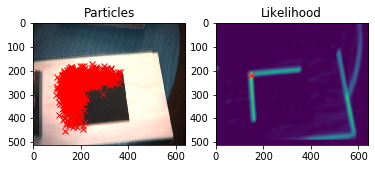

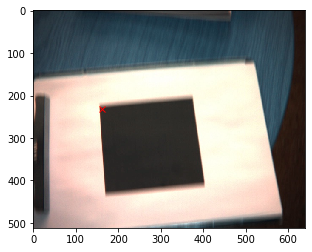

Processing Frame 60
[161.50282723 215.21874017]


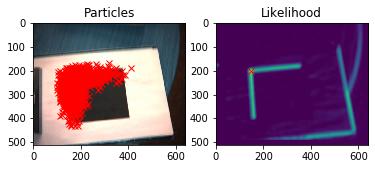

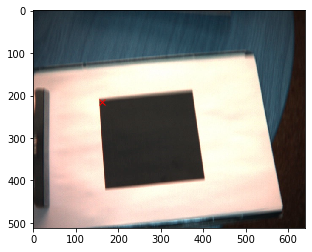

Processing Frame 61
[160.56188258 203.50225349]


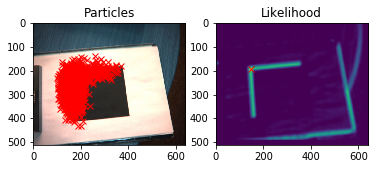

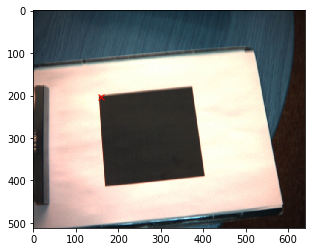

Processing Frame 62
[160.12942973 202.41284498]


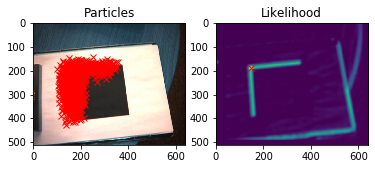

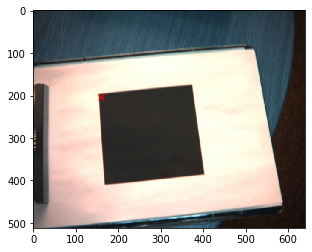

Processing Frame 63
[158.20620519 198.95994959]


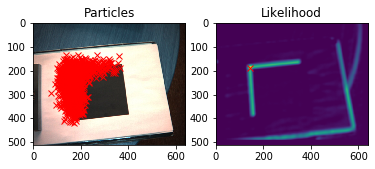

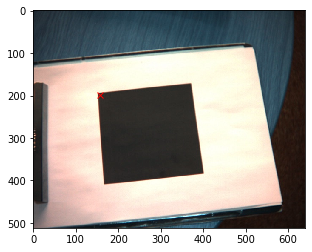

Processing Frame 64
[158.84411512 198.81819474]


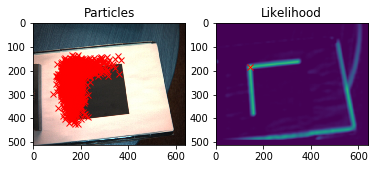

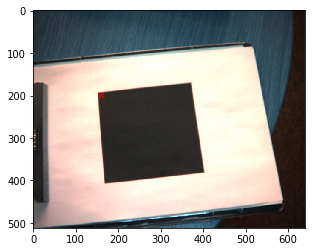

Processing Frame 65
[159.28560932 196.81725464]


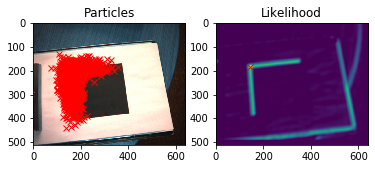

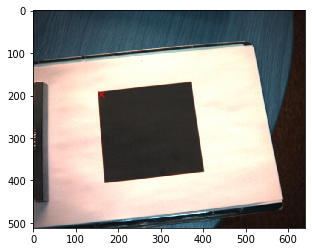

Processing Frame 66
[156.86529045 196.2119968 ]


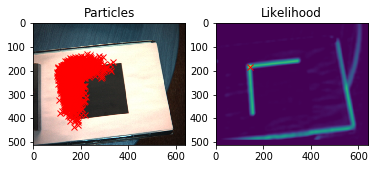

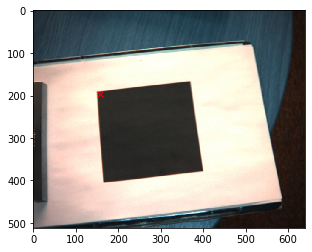

Processing Frame 67
[154.58110601 195.71988754]


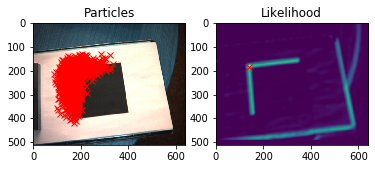

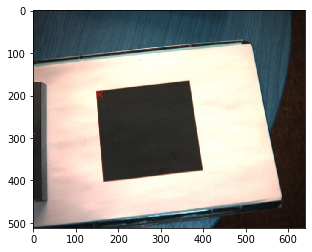

Processing Frame 68
[154.1447301  192.89541033]


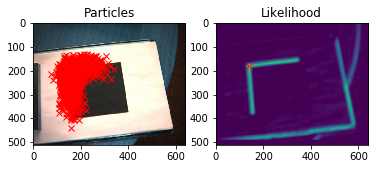

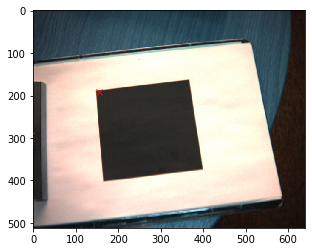

Processing Frame 69
[154.77148349 191.82673209]


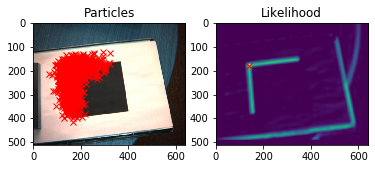

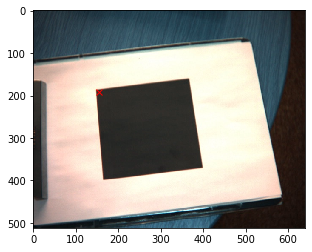

Processing Frame 70
[153.8665257  190.97485368]


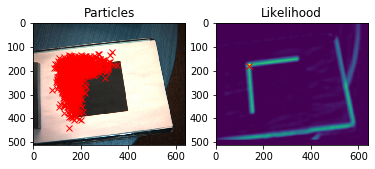

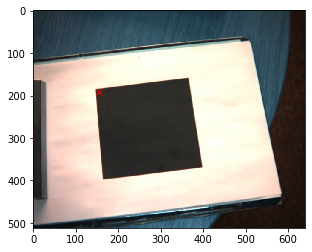

Processing Frame 71
[152.74149648 191.01557426]


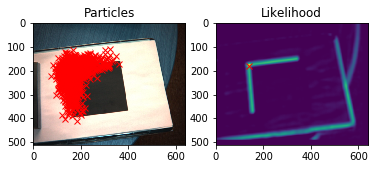

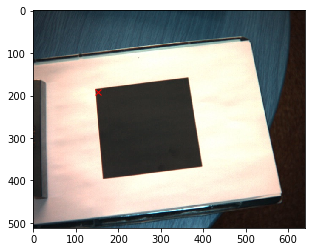

Processing Frame 72
[154.66241473 187.57575845]


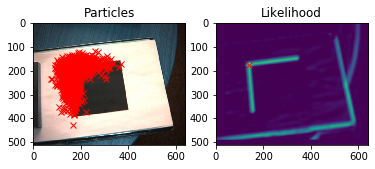

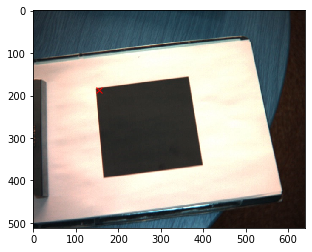

Processing Frame 73
[155.61088812 186.79347177]


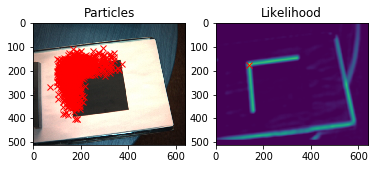

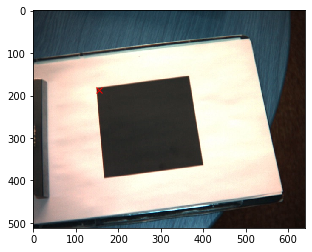

Processing Frame 74
[156.14430948 189.72529807]


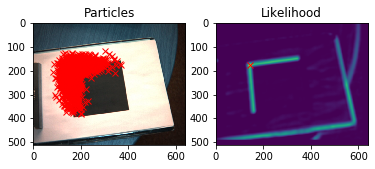

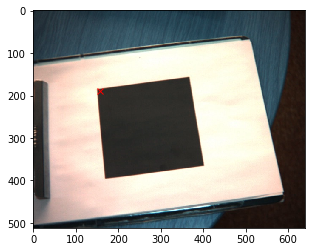

Processing Frame 75
[159.29148542 193.40115998]


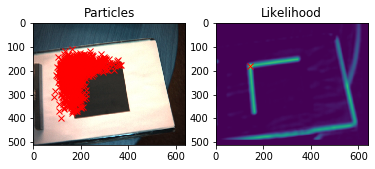

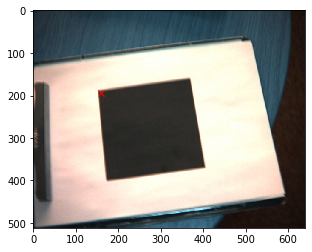

Processing Frame 76
[166.84308433 198.1872488 ]


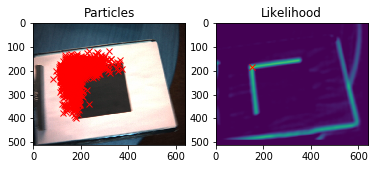

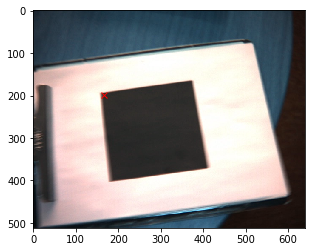

Processing Frame 77
[180.56344495 195.27950068]


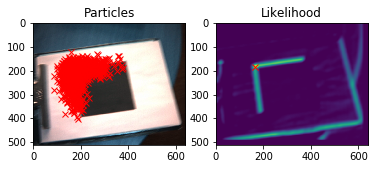

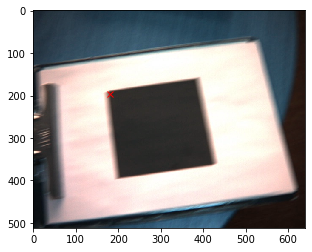

Processing Frame 78
[194.74532214 187.52580125]


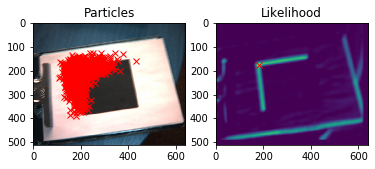

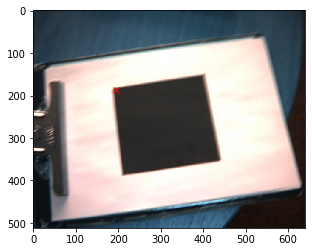

Processing Frame 79
[198.79416912 182.33406068]


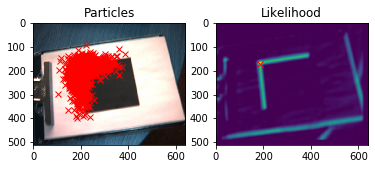

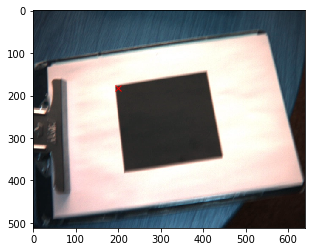

Processing Frame 80
[203.6060071  171.72063907]


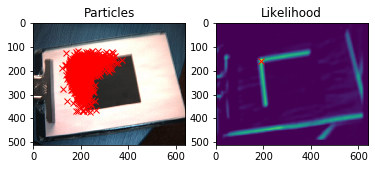

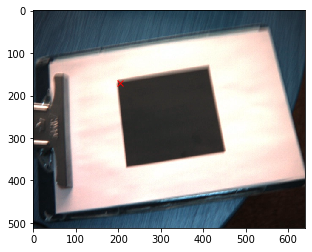

Processing Frame 81
[206.93730655 163.88777903]


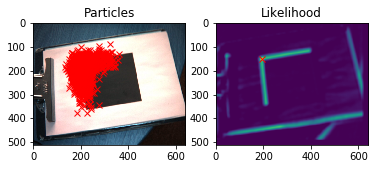

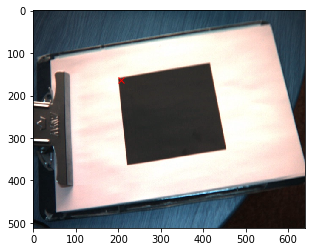

Processing Frame 82
[205.00947804 160.60091329]


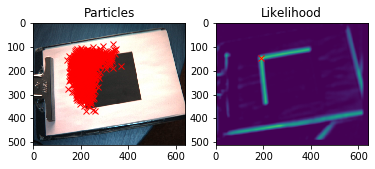

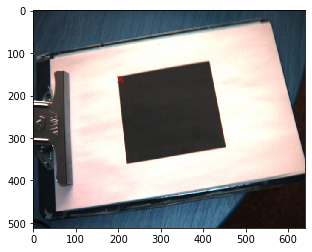

Processing Frame 83
[204.53880356 157.25140052]


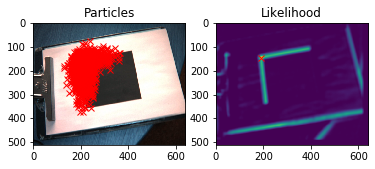

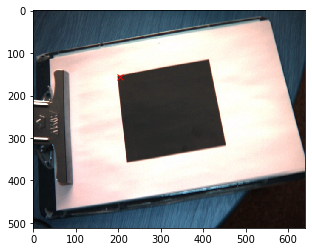

Processing Frame 84
[202.06253083 155.71260134]


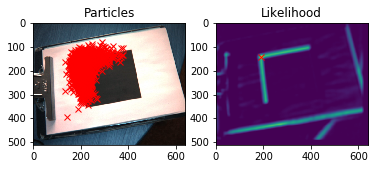

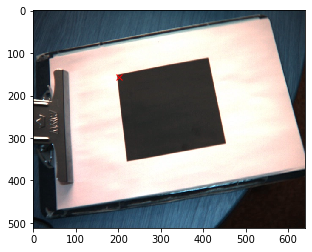

Processing Frame 85
[203.81728589 153.32978055]


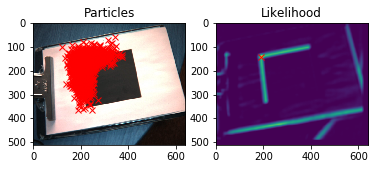

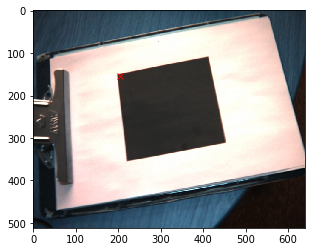

Processing Frame 86
[200.70233522 157.43873201]


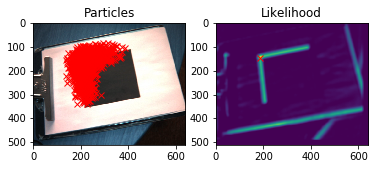

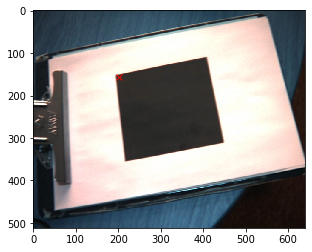

Processing Frame 87
[197.56599842 156.13161146]


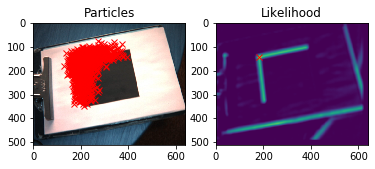

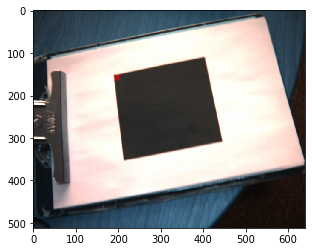

Processing Frame 88
[194.75420777 153.21179804]


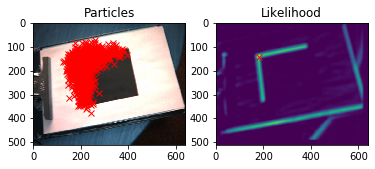

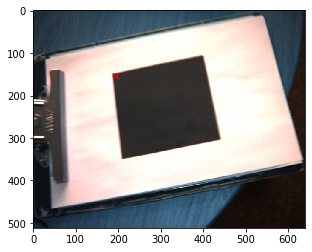

Processing Frame 89
[187.51611014 155.26227062]


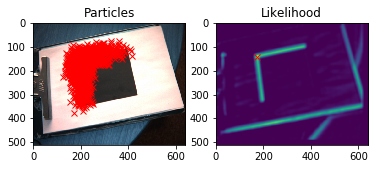

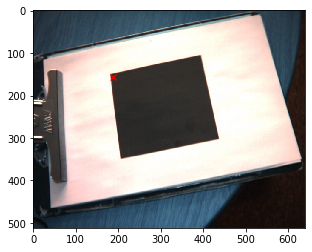

Processing Frame 90
[188.97166625 151.24245262]


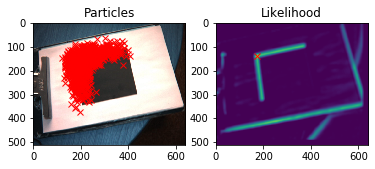

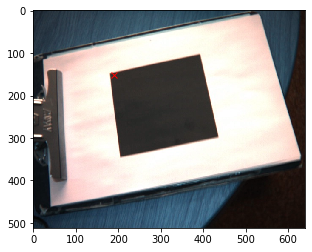

Processing Frame 91
[186.35107942 151.00767909]


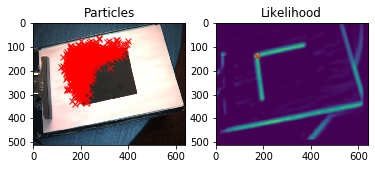

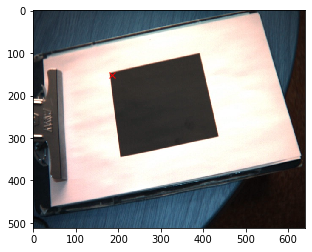

Processing Frame 92
[186.16098797 150.8760533 ]


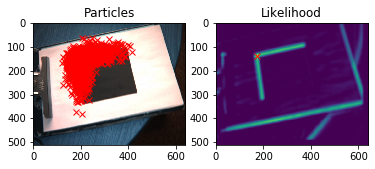

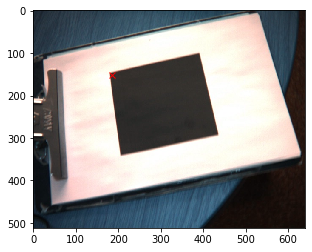

Processing Frame 93
[187.33855195 147.34165561]


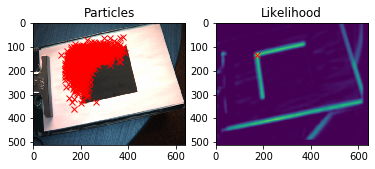

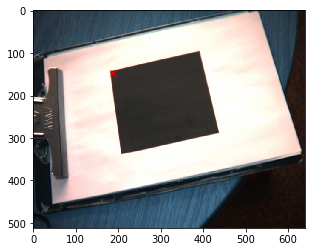

Processing Frame 94
[187.22895978 146.38793931]


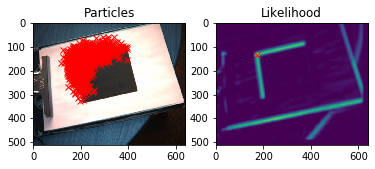

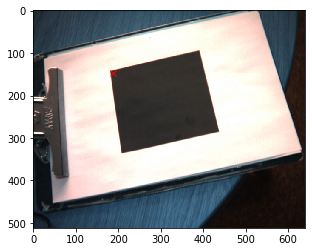

Processing Frame 95
[188.96879617 143.69610003]


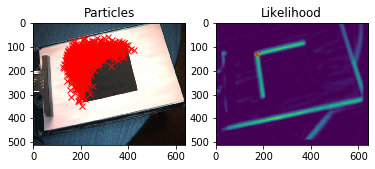

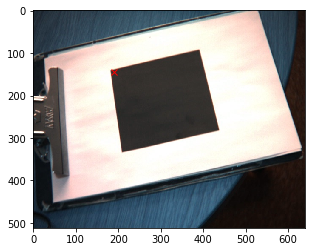

Processing Frame 96
[187.8996979  146.85314435]


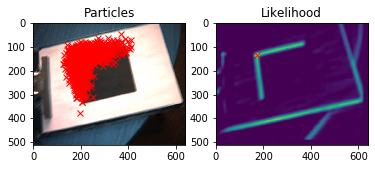

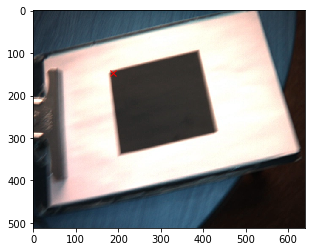

Processing Frame 97
[176.98882541 158.30465366]


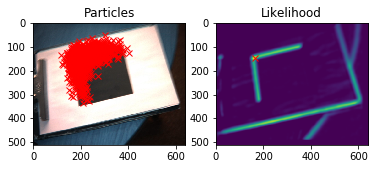

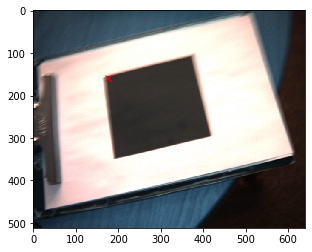

Processing Frame 98
[164.86499884 163.76541296]


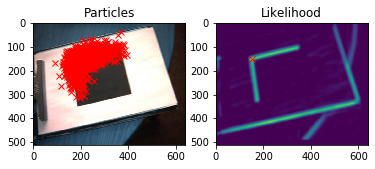

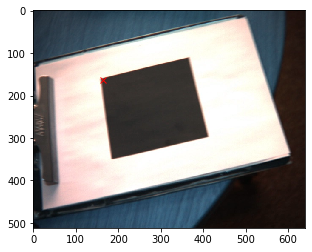

Processing Frame 99
[160.18234869 168.13451443]


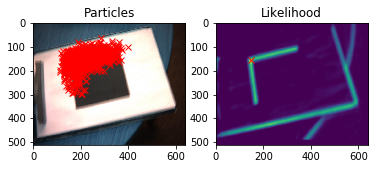

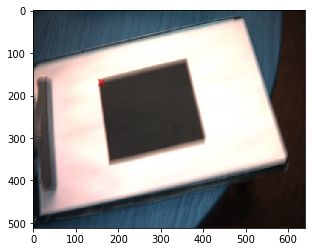

Processing Frame 100
[154.1750856 184.689754 ]


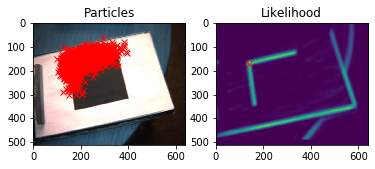

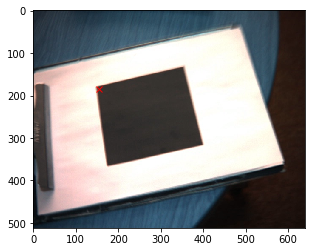

Processing Frame 101
[153.26659295 181.10355307]


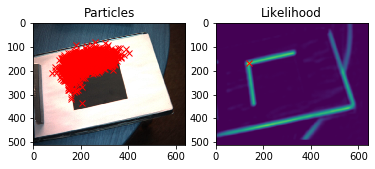

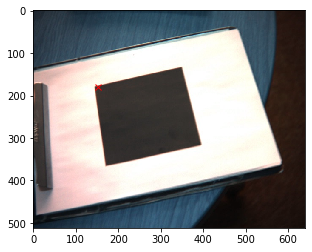

Processing Frame 102
[148.30094607 185.40845614]


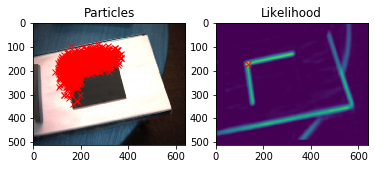

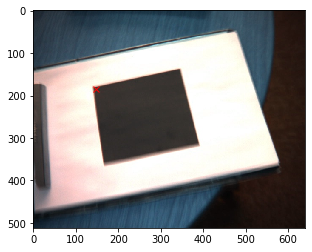

Processing Frame 103
[147.82352392 174.21632149]


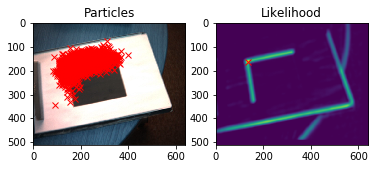

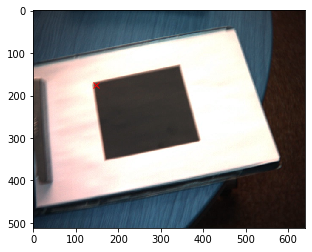

Processing Frame 104
[150.94079983 166.8694313 ]


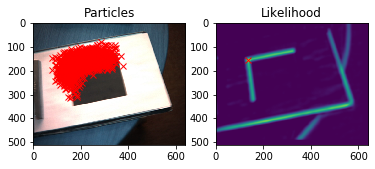

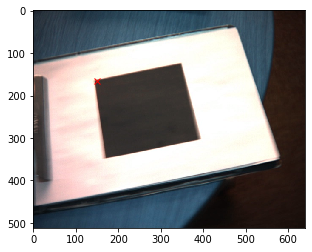

Processing Frame 105
[141.82030361 166.51319947]


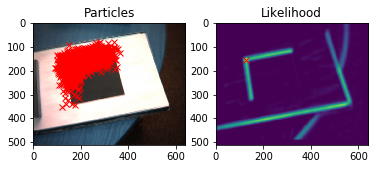

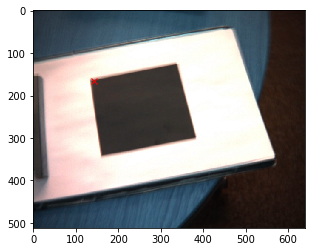

Processing Frame 106
[144.20433532 160.74747182]


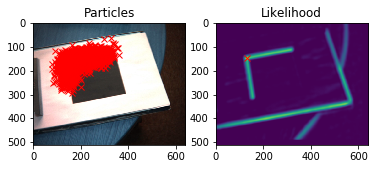

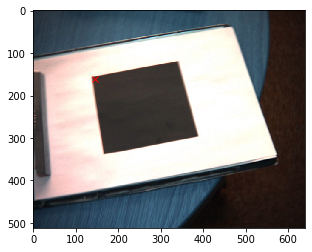

Processing Frame 107
[146.15057603 158.23285761]


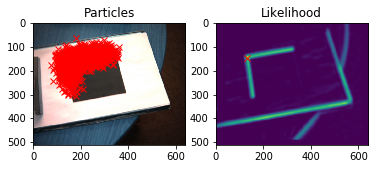

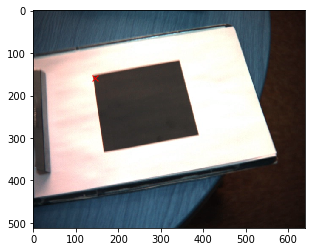

Processing Frame 108
[145.7977027  155.84711685]


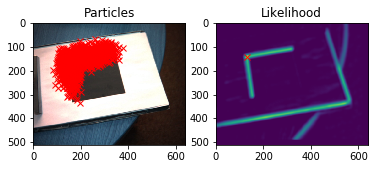

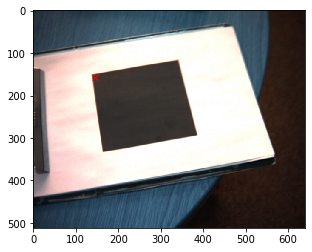

Processing Frame 109
[145.39505426 155.20285803]


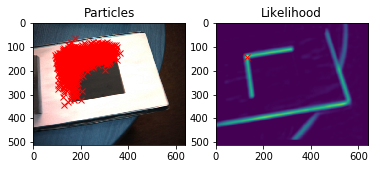

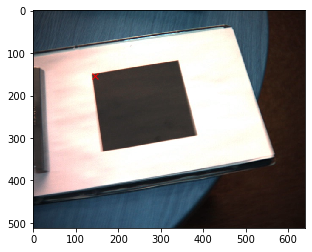

Processing Frame 110
[137.4271731  155.39219415]


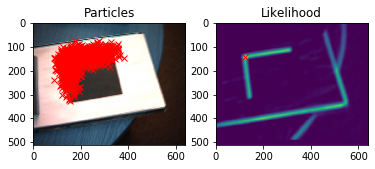

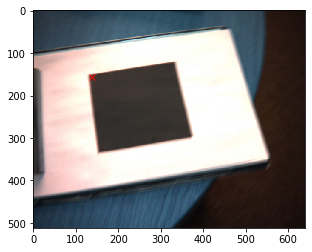

Processing Frame 111
[131.92716551 165.4223333 ]


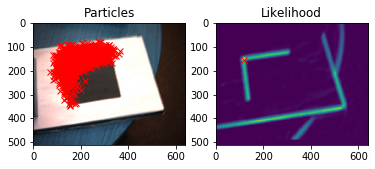

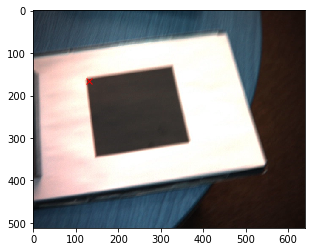

Processing Frame 112
[125.78998023 171.15985586]


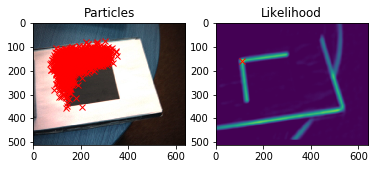

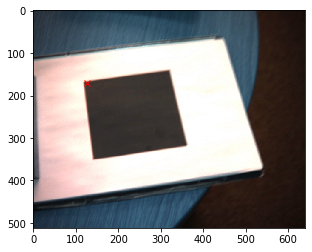

Processing Frame 113
[121.0162122  176.31801978]


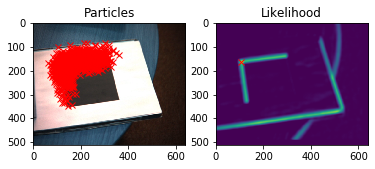

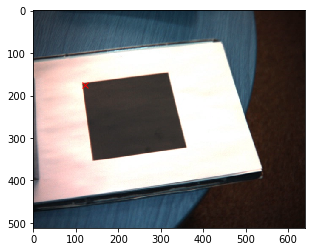

Processing Frame 114
[126.94149141 177.00717916]


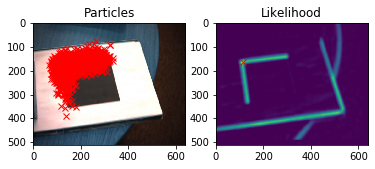

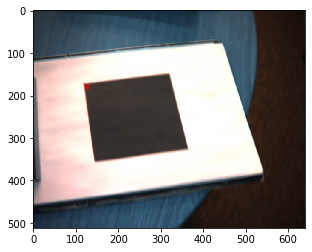

Processing Frame 115
[127.55334945 181.76448939]


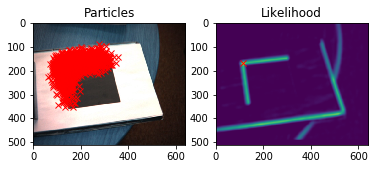

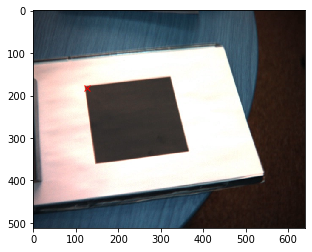

Processing Frame 116
[132.72028534 181.29527802]


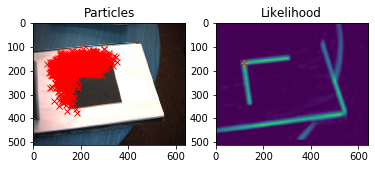

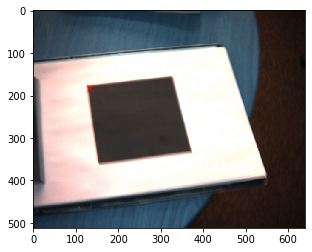

Processing Frame 117
[137.65445945 189.40815622]


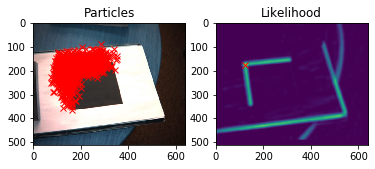

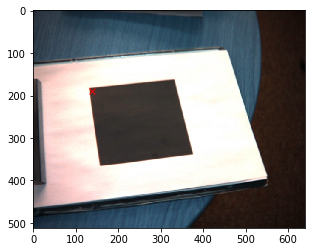

Processing Frame 118
[142.54085341 187.91824621]


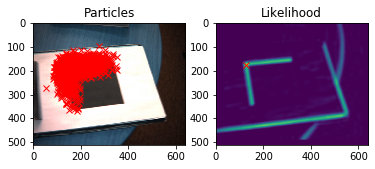

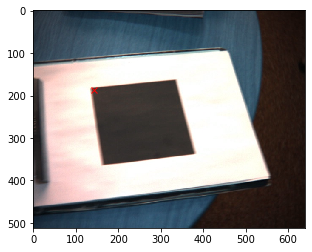

Processing Frame 119
[151.63402471 185.5184312 ]


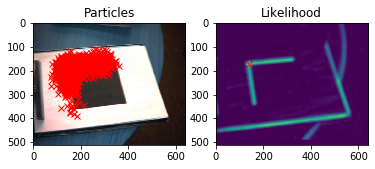

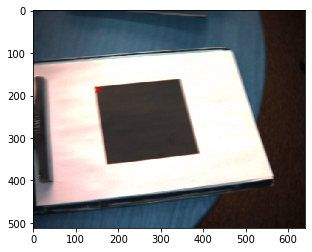

Processing Frame 120
[159.89233546 185.87749322]


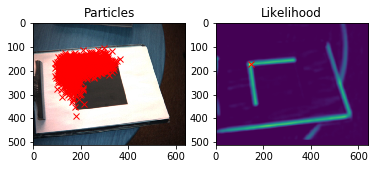

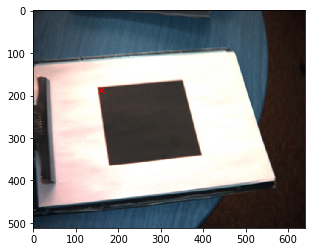

Processing Frame 121
[163.60538587 186.68423519]


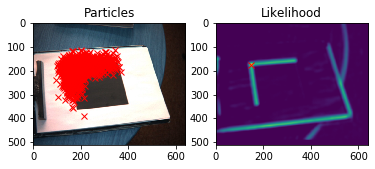

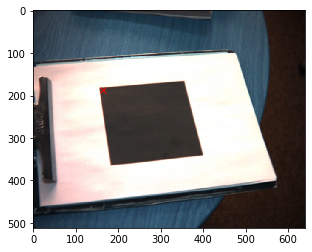

Processing Frame 122
[166.26788888 184.24041195]


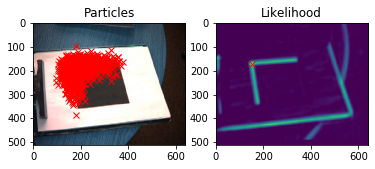

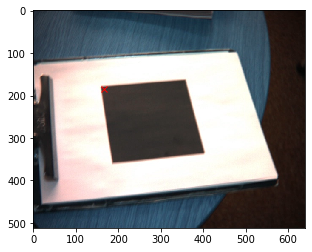

Processing Frame 123
[168.93967226 179.01416378]


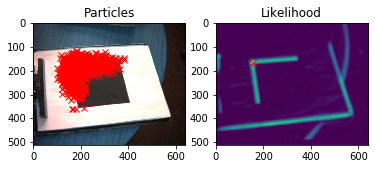

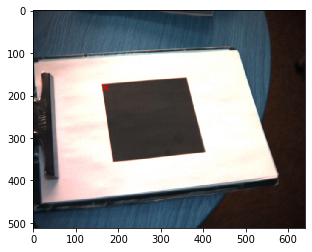

Processing Frame 124
[165.22349308 181.4837842 ]


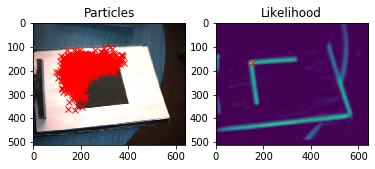

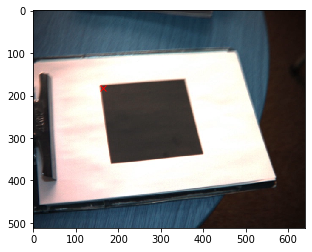

Processing Frame 125
[159.6190044  179.50498684]


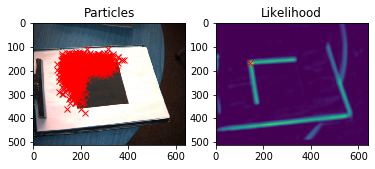

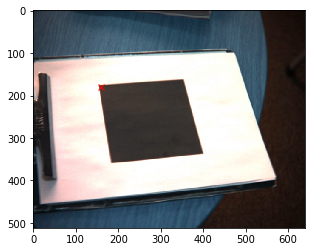

Processing Frame 126
[165.55362239 178.87125196]


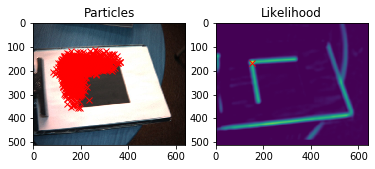

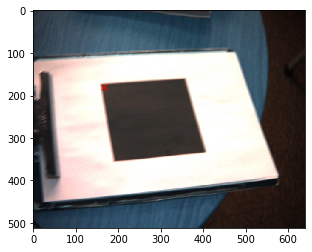

Processing Frame 127
[171.48712062 174.19627855]


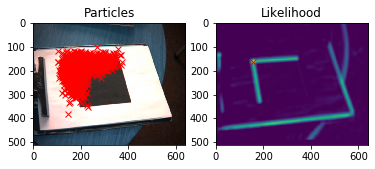

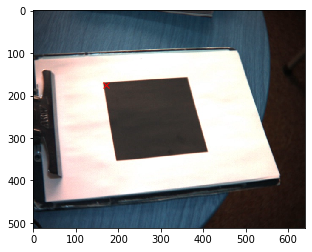

Processing Frame 128
[174.94132722 176.81570548]


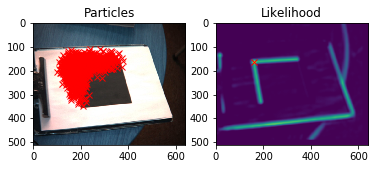

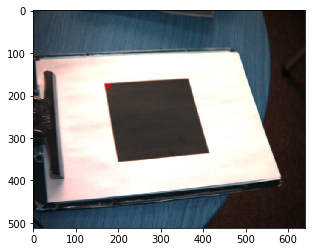

Processing Frame 129
[176.79113555 177.51832548]


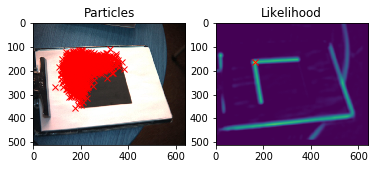

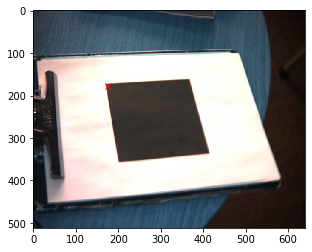

Processing Frame 130
[173.95563838 182.60052956]


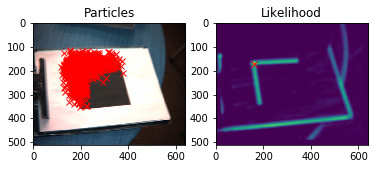

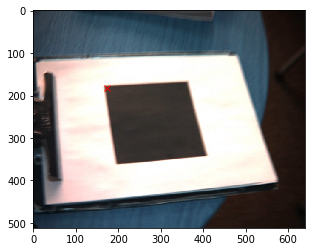

Processing Frame 131
[164.55604073 182.49247455]


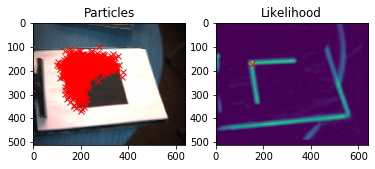

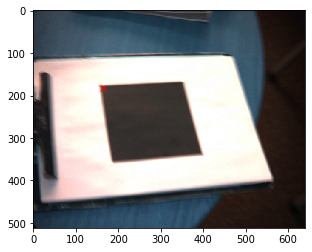

Processing Frame 132
[156.7841767  172.51917319]


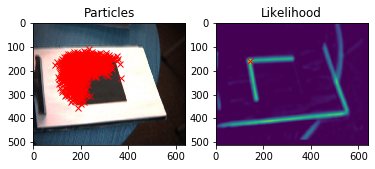

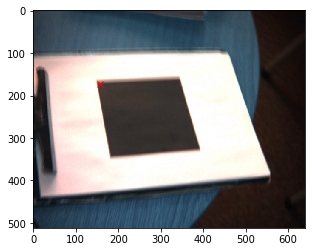

Processing Frame 133
[156.20574807 161.94282427]


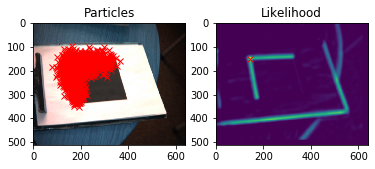

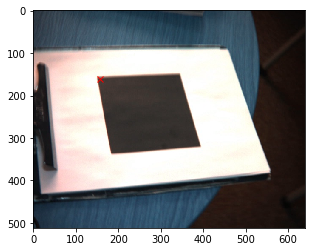

Processing Frame 134
[154.64235131 158.13123599]


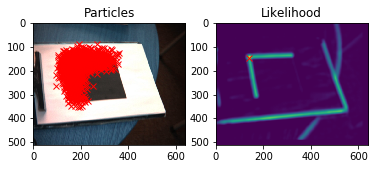

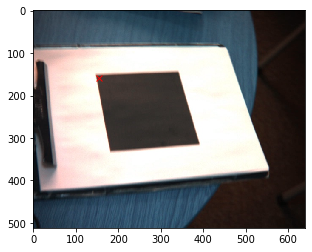

Processing Frame 135
[154.9418931  148.25396189]


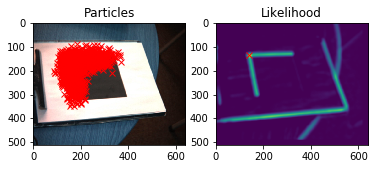

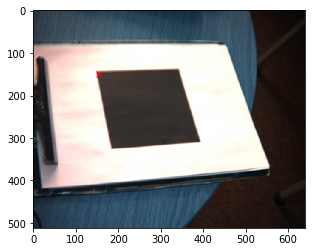

Processing Frame 136
[159.48443686 146.1386719 ]


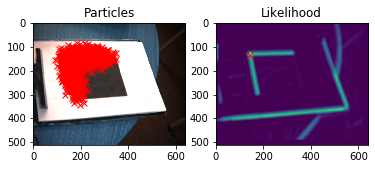

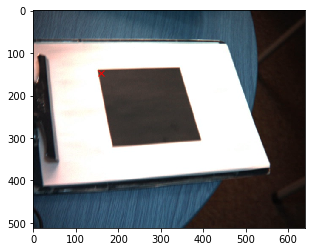

Processing Frame 137
[160.25639012 140.08127087]


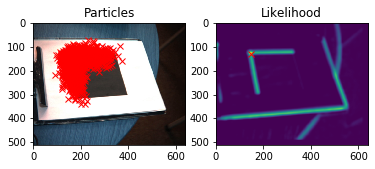

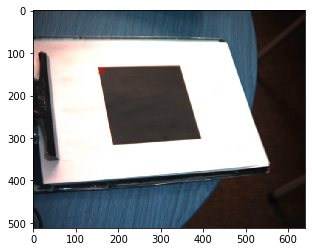

Processing Frame 138
[159.47418165 138.41236524]


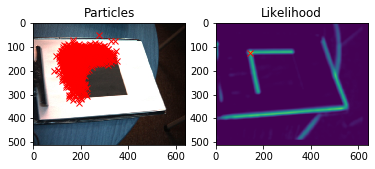

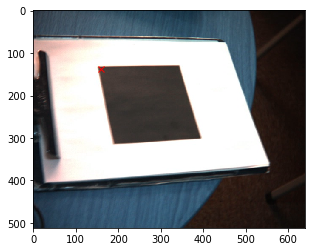

Processing Frame 139
[165.90379743 133.825119  ]


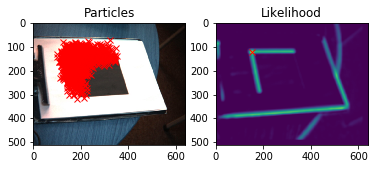

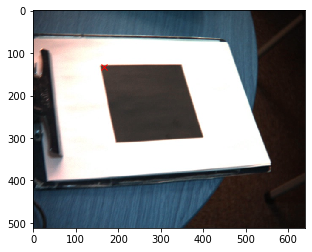

Processing Frame 140
[169.75425801 130.82901388]


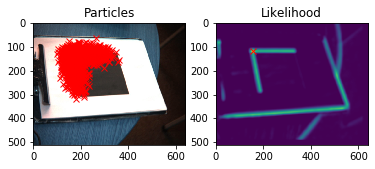

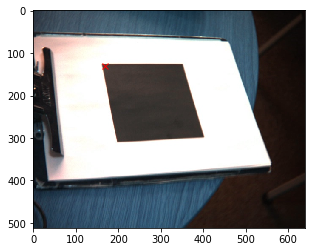

Processing Frame 141
[167.0488734  134.88047269]


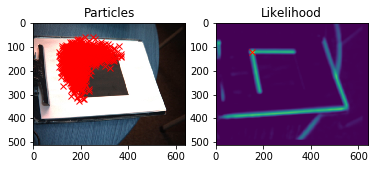

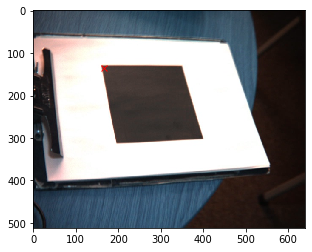

Processing Frame 142
[165.91704942 131.8776299 ]


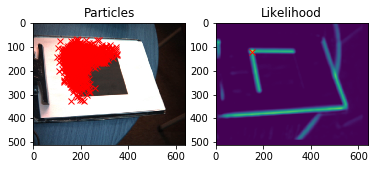

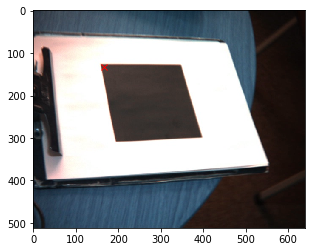

Processing Frame 143
[161.65443792 130.97874473]


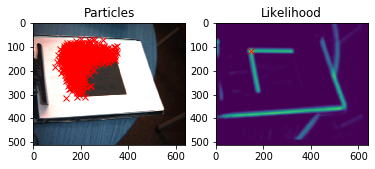

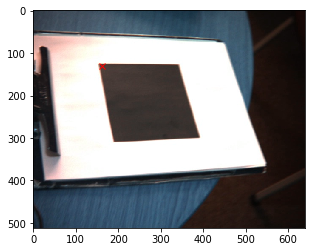

Processing Frame 144
[154.56704559 134.8382241 ]


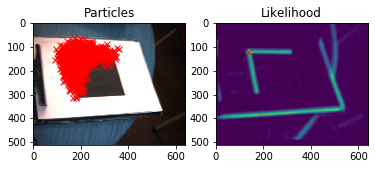

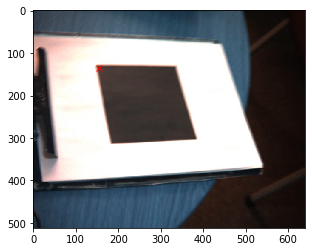

Processing Frame 145
[148.07407143 129.53739027]


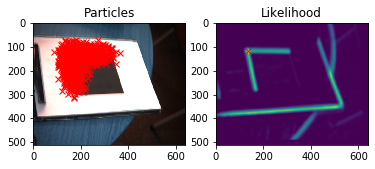

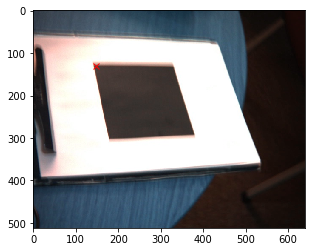

Processing Frame 146
[144.82285463 123.6502092 ]


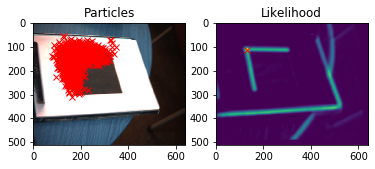

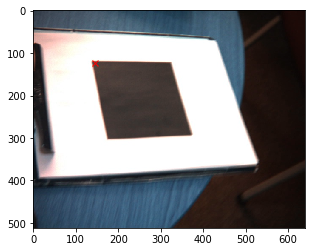

Processing Frame 147
[139.50774416 132.31554719]


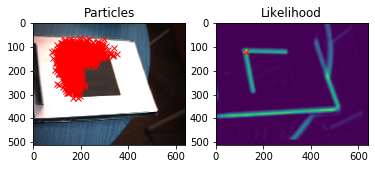

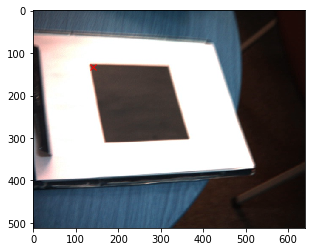

Processing Frame 148
[133.80411313 135.20096852]


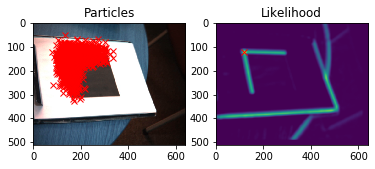

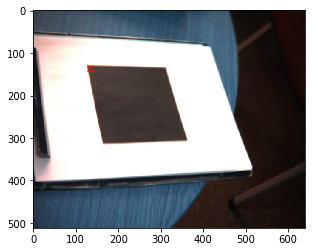

Processing Frame 149
[135.06332743 137.93354512]


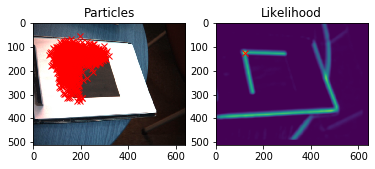

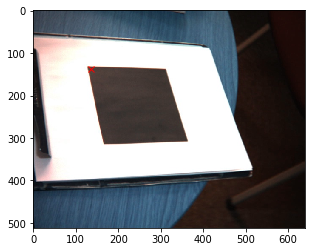

Processing Frame 150
[133.10886157 136.20670591]


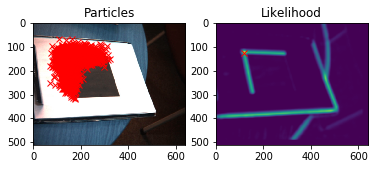

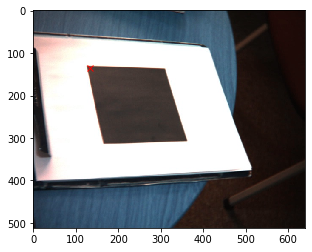

In [4]:
r = HW2_Practical9c('ul')

Explanation: This part is similar to what we did in lab9 Part B: Condensation. We are trying to track the given templte - upper left corner with moving frames. Initially, the particles are randomly spread within the image.And we can also examine that at the beginning steps, many particles hit the wrong target, this is beacause we use a larger noise.However, after 150 processing almost all particles gather at the upper left corner of our image. We just apply the same algorithm as the lab9 in this stage. However, in next step, we need to run our four times(once each with 'll','lr', 'ul', 'ur': lower left, lower right, upper left, ipper right) and we still need to track the given template respectively.